In [10]:
import helper

import numpy as np
import pandas as pd
import collections
import matplotlib.pyplot as plt

from sklearn.ensemble import RandomForestRegressor

import warnings
warnings.filterwarnings('ignore')

In [11]:
# Load data
east_data = pd.read_csv('east_data_clean.csv')
west_data = pd.read_csv('west_data_clean.csv')
lower_data = pd.read_csv('lower_data_clean.csv')

In [12]:
dataset = helper.generate_condition_label(east_data,threshold=2,direction='east')    

In [13]:
dataset = dataset[dataset['condition']=='normal']
dataset = dataset.drop(['date_time','weather','condition'],axis=1)

res,_ = helper.model_predict(dataset)

res

[4.936730612410198,
 3.6444191477660066,
 2.8772136328499616,
 6.927960448641286,
 2.892843188766716,
 5.430244930385005,
 3.9702467235085637,
 3.414318792634393,
 5.739853891397905]

In [3]:
# Calculate the daily MAPE and return its corresponding daily dataset
day_dict,data_dict,mape_dict = helper.mape_distribution(east_data)

## Histogram plot
# histogram(mape_dict,'east_roof_hist',False)

In [46]:
east_defect = ['20180116','20180925','20181130','20181202','20181216','20181226','20190118','20190124','20190129',
          '20190228','20190220','20171114','20171223','20180115','20180122','20180131','20180201','20180206',
          '20180210','20180219','20180223','20180225','20180326','20180406','20180417','20180626','20180707',
          '20180709','20180710','20180712','20180718','20180720','20180823','20180905','20181211','20181010',
          '20181018','20181021','20181111','20181118','20181213','20181121','20181124','20181129','20181201',
          '20181204','20181217','20181224','20190110','20190219','20190308','20190912','20191114','20191213',
          '20190104','20190126','20190206','20190305','20190313','20190924','20191118','20190108','20190204',
          '20190217','20190307','20190901','20191107','20191210','20170914','20170930','20171005','20171019',
          '20171020','20171021','20171022','20171104','20171108','20171109','20171202','20171205','20171207',
          '20171208','20171211','20171220','20180124','20180127','20180202','20180203','20180205','20180213',
          '20180228','20180324','20180325','20180614','20180617','20180620','20180622','20200104','20200106',
          '20180709','20180719','20180814','20181026','20181107','20181119','20181122','20181128','20181208',
          '20181209','20181210','20181218','20181219','20181227','20190102','20190117','20190108','20190130',
          '20200105','20200110','20190209','20190215','20190216','20190228','20190301','20190306','20190309',
          '20190310','20190323','20190426','20190720','20191019','20191104','20191124','20191128','20191212',
          '20191226','20191231']

len(east_defect)

137

In [53]:
# low_mape_day = [*day_dict['0-5'],*day_dict['5-10'],*day_dict['10-15']]
# low_mape_data = [*data_dict['0-5'],*data_dict['5-10'],*data_dict['10-15']]

# low_mape_day = [*day_dict['0-5'],*day_dict['5-10']]
# low_mape_data = [*data_dict['0-5'],*data_dict['5-10']]

low_mape_day = [*day_dict['0-5']]
low_mape_data = [*data_dict['0-5']]
len(low_mape_day)

48

In [54]:
normal_day = []

for ith, data in enumerate(low_mape_data):
    day = low_mape_day[ith]
    if day not in defect:
        normal_day.append(day)

In [62]:
dataset = lower_data

n = len(dataset)
condition = []

for i in range(n):
    day = str(dataset.loc[i]['date_time'])[:8]
    if day in normal_day:
        condition.append('normal')
    else:
        condition.append('anomaly')
        
dataset['condition'] = condition
dataset

,date_time,panel_1_power,panel_2_power,panel_3_power,panel_4_power,panel_5_power,panel_6_power,panel_7_power,panel_8_power,panel_9_power,panel_10_power,weather,condition
0,201709120646,1.145,2.255,2.061,0.670,1.749,0.886,1.256,2.296,1.323,0.961,sunny,normal
1,201709120648,2.072,2.255,2.061,0.670,2.236,0.886,2.287,2.296,1.323,0.974,sunny,normal
2,201709120649,2.313,2.255,2.061,2.385,2.485,0.925,2.554,2.398,1.323,1.015,sunny,normal
3,201709120650,2.551,2.483,2.633,2.654,2.725,0.962,2.765,2.500,2.615,1.020,sunny,normal
4,201709120651,2.800,2.750,2.804,2.849,2.925,0.962,3.000,2.943,2.855,1.019,sunny,normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
90746,202001141625,1.436,1.509,1.582,1.582,0.000,0.000,1.709,1.528,1.704,0.000,cloudy,anomaly
90747,202001141626,1.396,1.453,1.510,1.569,0.000,0.118,1.679,1.547,1.596,0.000,cloudy,anomaly
90748,202001141627,1.333,1.296,1.143,1.393,0.000,0.000,1.566,1.436,1.554,0.000,cloudy,anomaly
90749,202001141628,0.960,0.882,1.098,1.019,0.000,0.000,1.154,0.960,0.909,0.000,cloudy,anomaly


In [63]:
dataset = dataset[dataset['condition']=='normal']
dataset = dataset.drop(['date_time','weather','condition'],axis=1)

res,_ = helper.model_predict(dataset)

{'whiskers': [<matplotlib.lines.Line2D at 0x7faa486bd290>,
 'caps': [<matplotlib.lines.Line2D at 0x7faa486f2c90>,
 'boxes': [<matplotlib.lines.Line2D at 0x7faa486d6550>],
 'medians': [<matplotlib.lines.Line2D at 0x7faa486d3710>],
 'fliers': [<matplotlib.lines.Line2D at 0x7faa486d3f10>],
 'means': [<matplotlib.lines.Line2D at 0x7faa486d3c10>]}

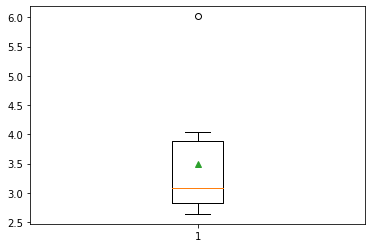

In [64]:
plt.boxplot(res,showmeans=True)

{'whiskers': [<matplotlib.lines.Line2D at 0x7faa698ffb90>,
 'caps': [<matplotlib.lines.Line2D at 0x7faa698cff50>,
 'boxes': [<matplotlib.lines.Line2D at 0x7faa698ffbd0>],
 'medians': [<matplotlib.lines.Line2D at 0x7faa698c1bd0>],
 'fliers': [<matplotlib.lines.Line2D at 0x7faa698dc610>],
 'means': [<matplotlib.lines.Line2D at 0x7faa698c1ed0>]}

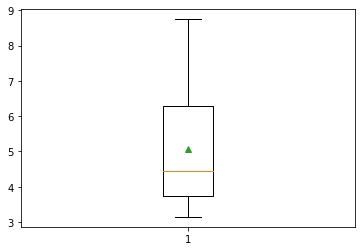

In [45]:
plt.boxplot(res,showmeans=True)

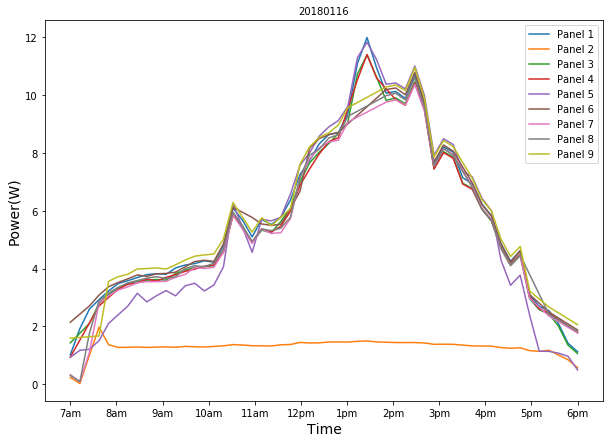

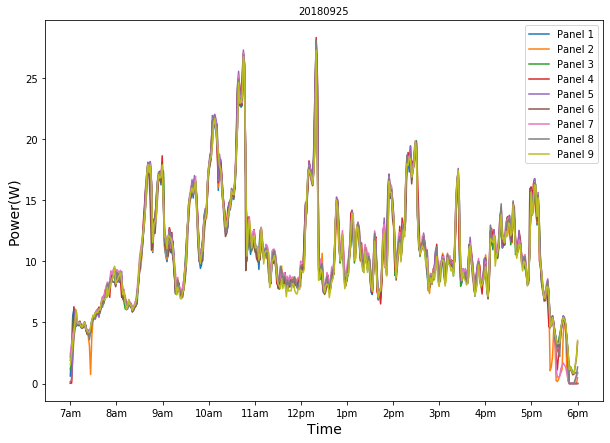

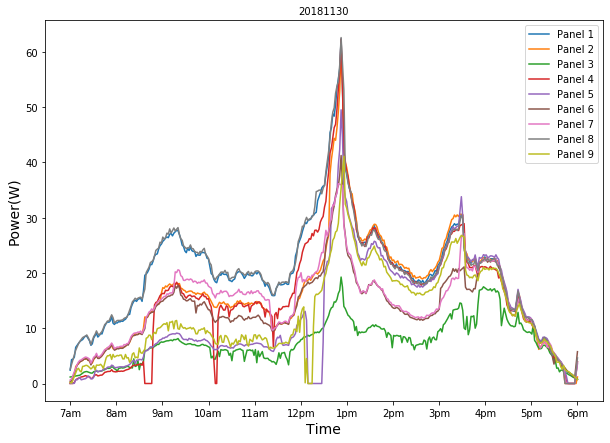

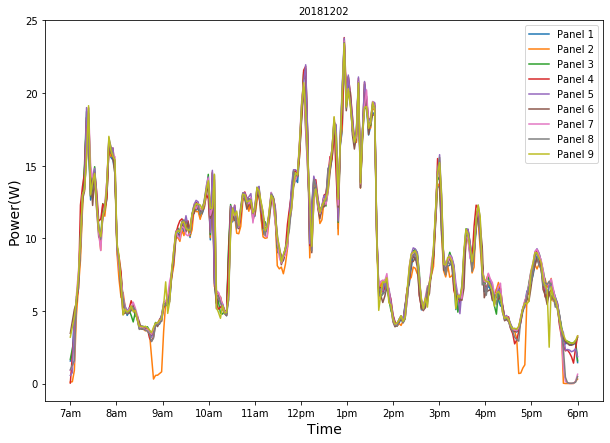

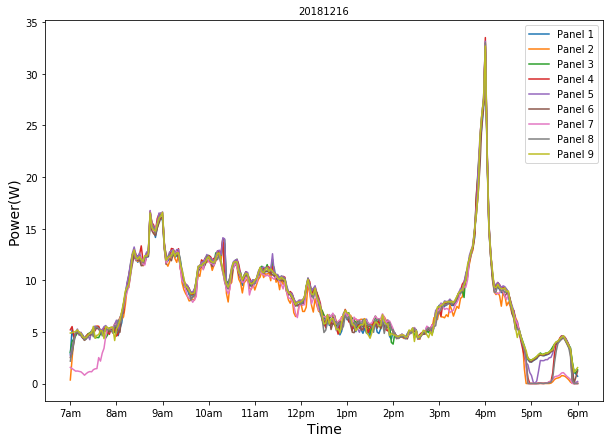

...

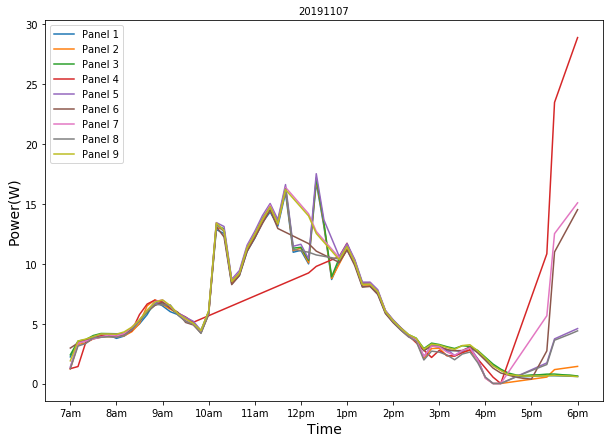

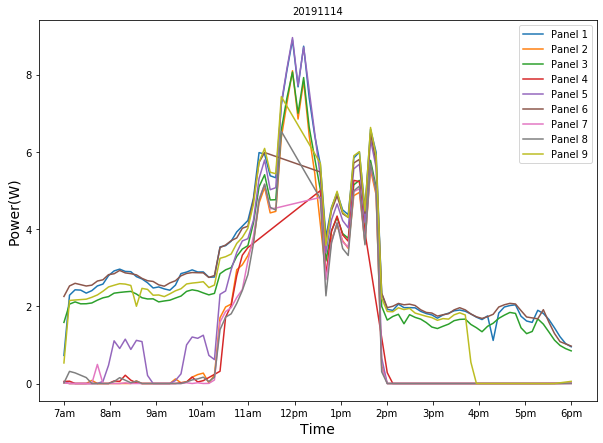

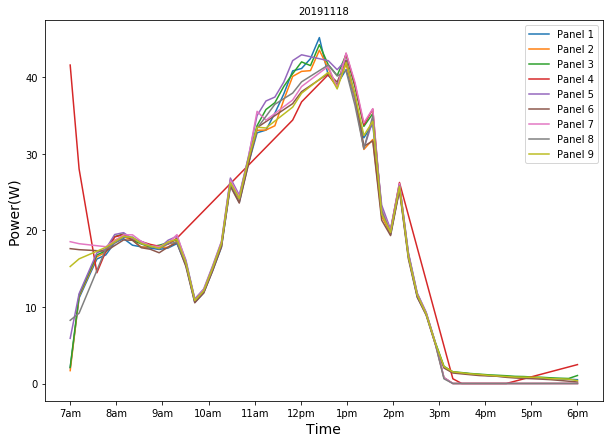

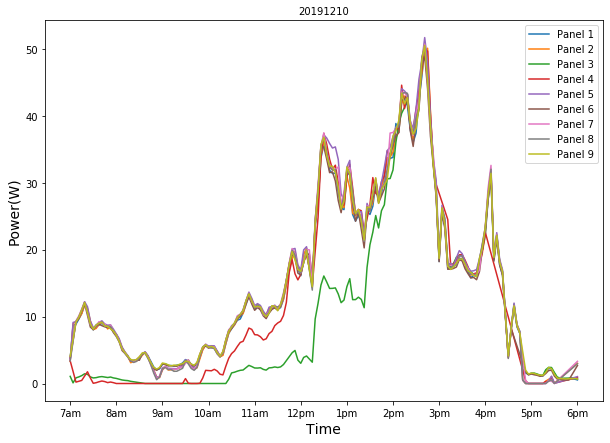

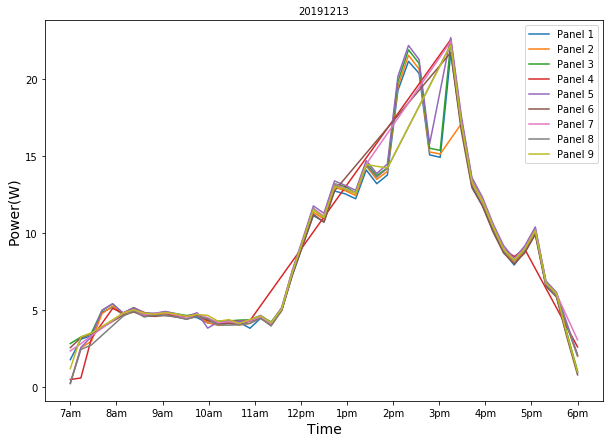

In [26]:
# for day,data in defect_data.items():
#     fig = plt.figure(figsize=(10,7))
#     ax = fig.add_subplot(1,1,1)
        
#     box = plt.plot(data)

#     indices = [i for i in data.index]
    
#     title = str(day)+" with MAPE "
    
#     ax.set_title(str(day),fontsize=10)
#     ax.set_xticks(np.linspace(indices[0],indices[-1],12))
#     ax.xaxis.set_ticklabels(['7am','8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm','5pm','6pm'])
#     ax.set_xlabel('Time',fontsize=14)
#     ax.set_ylabel('Power(W)',fontsize=14)
#     plt.legend(['Panel '+str(i+1) for i in range(len(data)-1)])
#     plt.show()

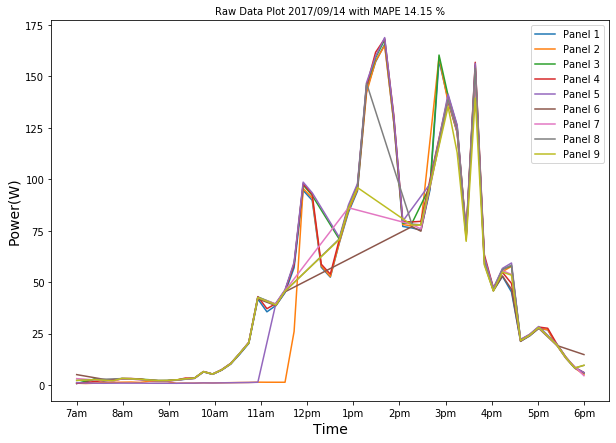

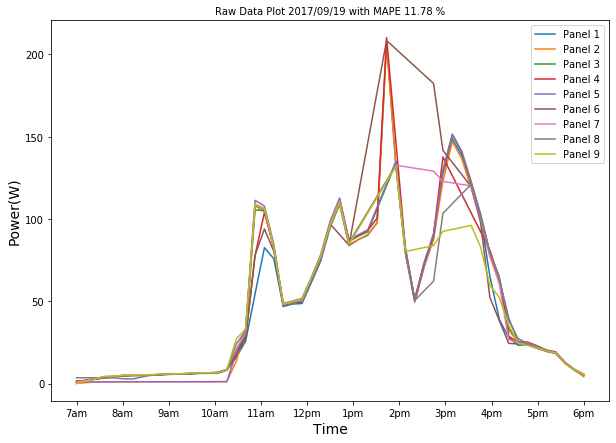

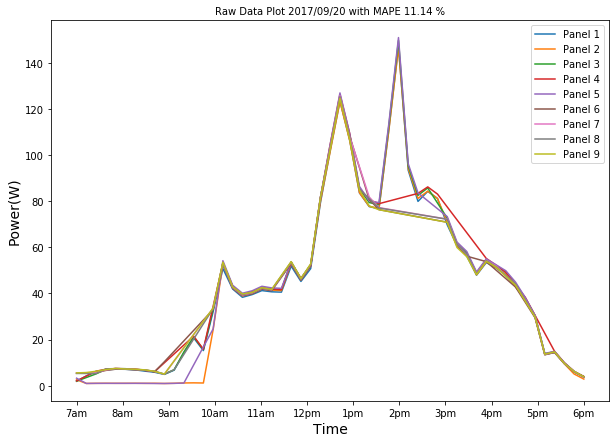

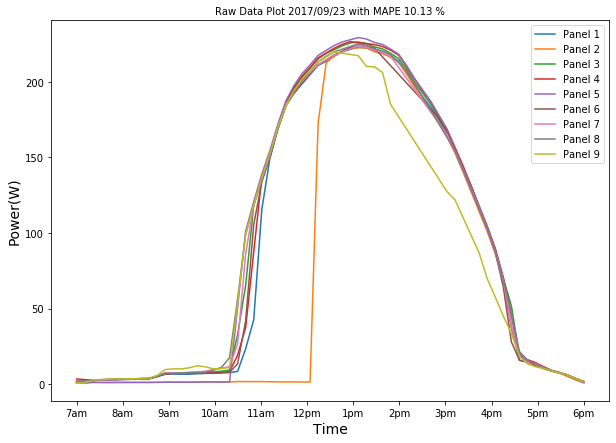

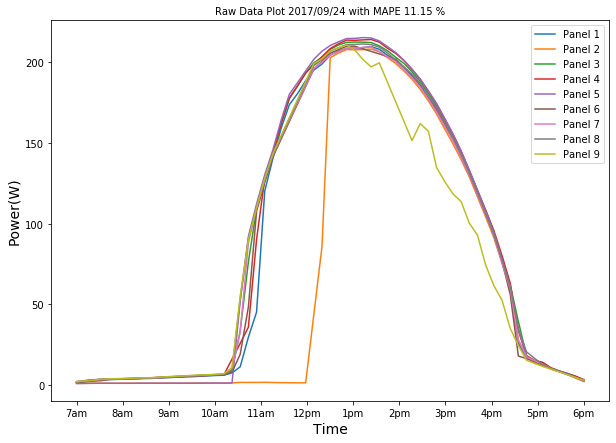

...

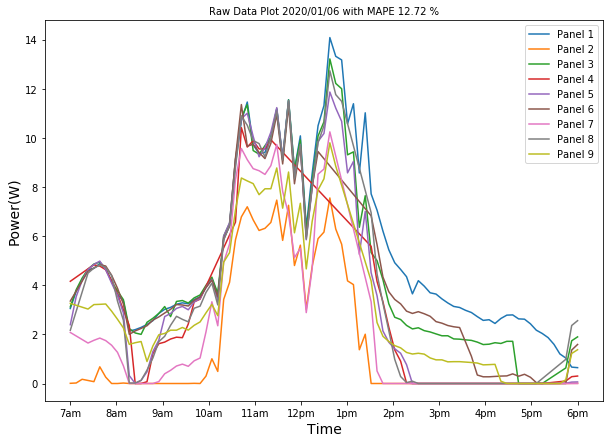

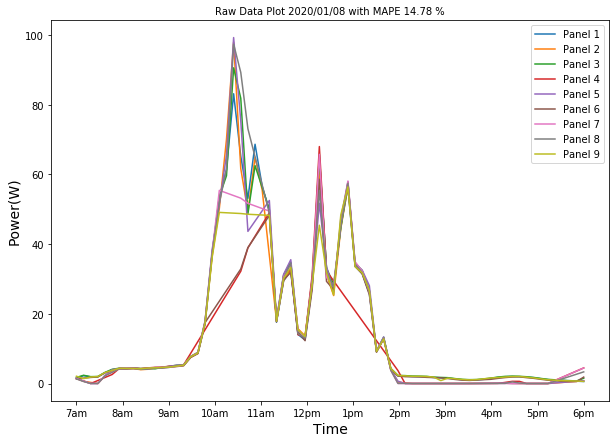

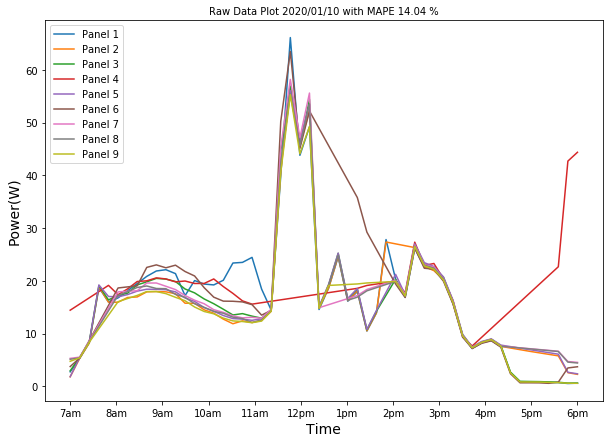

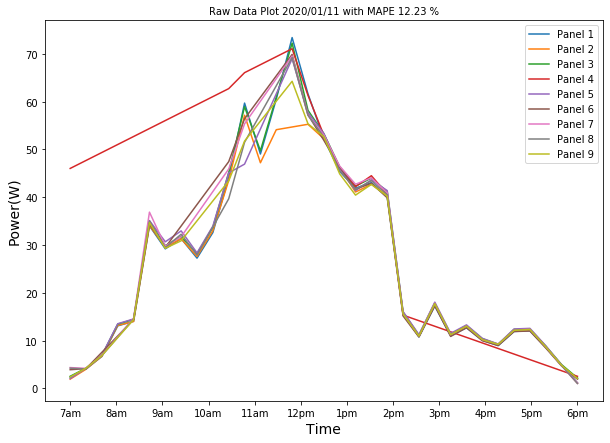

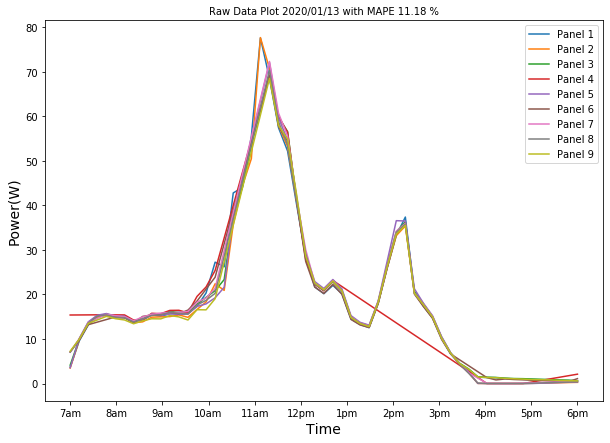

In [5]:
category = '10-15'

for ith, data in enumerate(data_dict[category]):
    
    fig = plt.figure(figsize=(10,7))
    ax = fig.add_subplot(1,1,1)
    
    day = day_dict[category][ith]
    day_ = day[:4]+"/"+day[4:6]+"/"+day[6:]
    mape = mape_dict[category][ith]
    
    box = plt.plot(data)

    indices = [i for i in data.index]
    
    title = str(day)+" with MAPE " + str(round(mape,2)) + " %"
    
    ax.set_title("Raw Data Plot "+str(day_)+" with MAPE " + str(round(mape,2)) + " %",fontsize=10)
    ax.set_xticks(np.linspace(indices[0],indices[-1],12))
    ax.xaxis.set_ticklabels(['7am','8am','9am','10am','11am','12pm','1pm','2pm','3pm','4pm','5pm','6pm'])
    ax.set_xlabel('Time',fontsize=14)
    ax.set_ylabel('Power(W)',fontsize=14)
    plt.legend(['Panel '+str(i+1) for i in range(len(data)-1)])
    plt.savefig("raw data plot "+title + '.jpg', format='jpg', dpi=100, bbox_inches='tight')   
    plt.show()
     

28.608626402066403


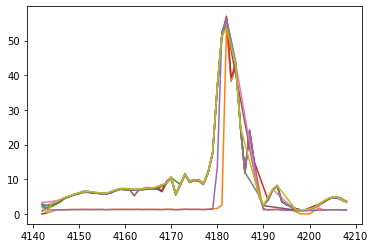

In [15]:
category = '20-30'
num = day_dict[category].index('20171122')
data = data_dict[category][num]
mape = np.mean(mape_dict[category][num])
date = day_dict[category][num]

print(mape_dict[category][num])

plt.plot(data)
plt.show()

# for i in range(len(data_dict['10-20'])):
#     print(i)
#     plt.plot(data_dict['10-20'][i])
#     plt.show()

# helper.raw_data_plot(data,"Raw Data Plot MAPE 30-40%, Date 2017-11-22",save=True)
# print(date)

export_csv = data.to_csv ('mape_30_40.csv', index = False, header=True)

In [16]:
data = pd.read_csv('mape_30_40.csv')
res,pred = helper.model_predict(data,return_pred=True)

In [17]:
for i, value in enumerate(pred):
    data['predict_'+str(i+1)] = value
export_csv = data.to_csv ('mape_30_40_new.csv', index = False, header=True)

In [5]:
mape_dict['10-20'][0]

NameError: name 'mape_dict' is not defined

In [49]:
# files = ['mape_greater_40.csv']

# for file in files:
    
#     data = pd.read_csv(file)
#     res,pred = helper.model_predict(data, return_pred=True)

#     cols = [col for col in data.columns]
#     for i, pred_value in enumerate(pred):
#         data["predicted_"+str(i+1)] = pred_value
#     export_csv = data.to_csv (file, index = False, header=True)
# print(np.mean(res))

In [129]:
day_list = []
mape_list = []

for i in day_dict:
    day_list.extend(day_dict[i])
    
for j in mape_dict:
    mape_list.extend(mape_dict[j])
    
day_mape = {day:mape for day,mape in zip(day_list,mape_list)}

In [130]:
day_set = []

for day in day_list:
    if day[4:] not in day_set:
        day_set.append(day[4:])
day_set.sort()

day_mape_set = {day:[] for day in day_set}

for day,mape in day_mape.items():
    day_mape_set[day[4:]].append(mape)
    
for day,mape_list in day_mape_set.items():
    day_mape_set[day] = np.mean(mape_list)

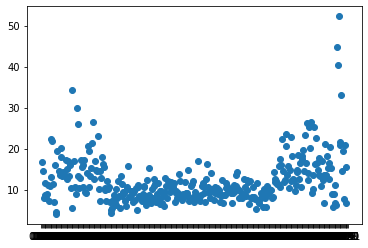

In [131]:
plt.scatter(list(day_mape_set.keys()), list(day_mape_set.values()))

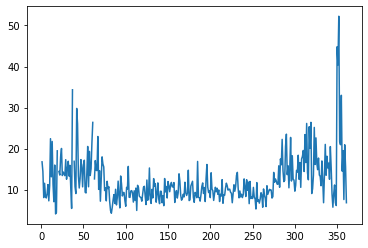

In [132]:
plt.plot(list(day_mape_set.values()))